In [1]:
PROG_NAME = "squeeze_expand_network_v0"

## Packages

In [2]:
!pip install tensorboard

In [3]:
from PIL import Image, ImageOps, ImageFilter
from torch import nn, optim
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
import torch.nn.functional as F

import logging
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import pandas as pd
import os
from tqdm import tqdm
from collections import defaultdict
from google.colab import drive
import zipfile
import random
from sklearn.decomposition import PCA
import torchvision.models as models

In [4]:
DEVICE =  'cuda' if torch.cuda.is_available() else 'cpu'

In [5]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
def torch_to_numpy(a):
    """
    Converts a torch tensor to a numpy array.
    """
    return a.detach().cpu().numpy()

## Data loader

In [7]:
def extract_zip(src_path, targ_path):
   """
   Extracts a zip file to a target directory.
   Input:
   src_path: str (path to zip file)
   targ_path: str (path to target directory)

   Output:
   No output.
   """
   with zipfile.ZipFile(src_path,"r") as zip_ref:
        zip_ref.extractall(targ_path)

In [8]:
class Transform:
    """
    Image Augmentaion Utilities
    """
    def __init__(
        self,
        reshaped_size = 64,
        normalize_mean=[0.485, 0.456, 0.406],
        normalize_std=[0.229, 0.224, 0.225]
    ):
        """
        The constructor creates a torch.transforms.Compose object. This object has sequential steps for the augmneations
        """
        self.transform = transforms.Compose([
            transforms.Resize(reshaped_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=normalize_mean, std=normalize_std)
        ])

    def __call__(self, x):
        """
        Tranforms x -> xt
        """
        xt = self.transform(x)
        return xt

In [9]:
def get_loaders(TAR_PATH,
                batch_size=32,
                reshaped_size=64,
                normalize_mean=[0.485, 0.456, 0.406],
                normalize_std=[0.229, 0.224, 0.225]):

    """
    It is wrapper function for getting train and test loaders.
    In each iteration it will yield a list of two tensors (X and Y)
    Shape of X : (batch_size, 3, reshaped_size, reshaped_size)
    Shape of Y : (batch_size)
    Note: X and Y are not type casted to device and type.

    Inputs:
      1. TAR_PATH : The parent directory that contains two sub-directories, train and test.
      2. batch_size
      3. reshaped_size: Input's Height / Width considering Height = Width
      4. normalize_mean
      5. normalize_std

    Output:
      1. train_dataset_loader
      2. test_dataset_loader
    """
    custom_transformer = Transform(
        reshaped_size=reshaped_size,
        normalize_mean=normalize_mean,
        normalize_std=normalize_std
    )

    train_dataset = torchvision.datasets.ImageFolder(f"{TAR_PATH}/train", custom_transformer)
    test_dataset = torchvision.datasets.ImageFolder(f"{TAR_PATH}/test", custom_transformer)
    train_dataset_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    test_dataset_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True)
    return train_dataset_loader, test_dataset_loader

In [10]:
# SRC_PATH = "/content/drive/MyDrive/ug26_3/ssl_ug4/datasets/cifar10.zip"
# TAR_PATH = "./cifar10/"
# extract_zip(SRC_PATH, TAR_PATH)

SRC_PATH = "/content/drive/MyDrive/all_datasets/mnist.zip"
TAR_PATH = "./mnist/"
extract_zip(SRC_PATH, TAR_PATH)

In [11]:
HEIGHT, WIDTH = 32,32
BATCH_SIZE = 256

# Dataloaders for train and test dataset respectively
TRAIN_DATASET_LOADER, TEST_DATASET_LOADER = get_loaders(
    TAR_PATH,
    batch_size=BATCH_SIZE,
    reshaped_size=HEIGHT,
    normalize_mean=[0.485, 0.456, 0.406],
    normalize_std=[0.229, 0.224, 0.225]
)

TOTAL_TRAIN_SAMPLES = len(TRAIN_DATASET_LOADER.dataset) # Total number of samples in train dataset
TOTAL_VAL_SAMPLES = len(TEST_DATASET_LOADER.dataset) # Total number of samples in val dataset
NUM_LABS = len(TRAIN_DATASET_LOADER.dataset.classes) # Total number of classes

In [12]:
# sample_x, sample_y = next(iter(TRAIN_DATASET_LOADER))
# sample_x.shape, sample_y.shape

## Metrics


In [13]:
class MulticlassMetrics:
    """
    This class buffers the metrics for multiclass classification.
    Also, estimates the average of the metrics whose values are stored in the buffer.
    """
    def __init__(self):
        self.reset_state() # Emptying the buffer

    def reset_state(self):
        self.metrics = defaultdict(list) # Initializing the map {metric->buffer(empty list)}

    def update_state(self, **kwargs):
        """
        Named arguments are expected to be in form of {metric:score}
        """
        for key in kwargs:
            self.metrics[key].append(kwargs[key]) # Appending metric wise scores

    def result(self):
        """
        Returns the average of the metrics whose values are stored in the buffer.
        """
        return {
             k: np.mean(self.metrics[k]) for k in self.metrics.keys()
        }

In [14]:
def calculate_f1_precision_recall_accuracy(y_true_oh, y_pred, average='macro'):
    """
    Inputs:
    - y_true_oh: (batch_size, num_classes) / Tensor[float]
    - y_pred: (batch_size, num_classes) / Tensor[float]
    - average: 'macro', 'micro', or 'weighted'

    Outputs:
    - f1_score : float tensor
    - precision : float tensor
    - recall : float tensor
    - acc : float tensor
    """
    y_pred = torch.argmax(y_pred, dim=1)
    y_true = torch.argmax(y_true_oh, dim=1)

    num_classes = y_true_oh.shape[1]

    # Initialize
    tp = torch.zeros(num_classes)
    fp = torch.zeros(num_classes)
    fn = torch.zeros(num_classes)
    support = torch.zeros(num_classes)  # number of true instances per class

    for i in range(num_classes):
        tp[i] = ((y_pred == i) & (y_true == i)).sum().item()
        fp[i] = ((y_pred == i) & (y_true != i)).sum().item()
        fn[i] = ((y_pred != i) & (y_true == i)).sum().item()
        support[i] = (y_true == i).sum().item()

    precision_per_class = tp / (tp + fp + 1e-8)
    recall_per_class = tp / (tp + fn + 1e-8)
    f1_per_class = 2 * (precision_per_class * recall_per_class) / (precision_per_class + recall_per_class + 1e-8)

    total_support = support.sum()

    if average == 'macro':
        precision = precision_per_class.mean()
        recall = recall_per_class.mean()
        f1_score = f1_per_class.mean()
    elif average == 'weighted':
        precision = (precision_per_class * support).sum() / (total_support + 1e-8)
        recall = (recall_per_class * support).sum() / (total_support + 1e-8)
        f1_score = (f1_per_class * support).sum() / (total_support + 1e-8)
    elif average == 'micro':
        # Micro = global TP/FP/FN
        tp_total = tp.sum()
        fp_total = fp.sum()
        fn_total = fn.sum()

        precision = tp_total / (tp_total + fp_total + 1e-8)
        recall = tp_total / (tp_total + fn_total + 1e-8)
        f1_score = 2 * (precision * recall) / (precision + recall + 1e-8)
    else:
        raise ValueError(f"Unsupported average type: {average}")

    acc = (tp.sum() + 1e-8) / (total_support + 1e-8)

    return f1_score, precision, recall, acc

In [15]:
def calculate_class_wise_accuracy(y_true_oh, y_pred):
    """
    Inputs:
    Shape of y_true_oh : (batch_size, num_classes) / Type: Tensor[Float]
    Shape of y_pred : (batch_size, num_classes) / Type: Tensor[Float]

    Output:
    class_wise_accuracy : dict
    """

    y_pred = torch.argmax(y_pred, dim=1)  # Predicted class indices
    y_true = torch.argmax(y_true_oh, dim=1)  # True class indices

    class_wise_accuracy = {}

    for i in range(y_true_oh.shape[1]):
        true_class_mask = (y_true == i)            # Samples where true label is class i
        total_true = true_class_mask.sum().item()   # Total number of samples of class i

        if total_true == 0:
            accuracy = 0.0
        else:
            correct_preds = (y_pred[true_class_mask] == i).sum().item()  # Correct predictions for class i
            accuracy = correct_preds / total_true

        class_wise_accuracy[f"class_{i}_accuracy_[skip]"] = accuracy

    return class_wise_accuracy


## Callbacks

In [16]:
class BaselineCallback():
    """
    Base class for a generic design of callbacks.
    """
    def __init__(self):
      pass

    def on_train_batch_begin(self, batch, logs={}):
      pass

    def on_test_batch_begin(self, batch, logs={}):
      pass

    def on_train_batch_end(self, batch, logs={}):
      pass

    def on_test_batch_end(self, batch, logs={}):
      pass

    def on_epoch_begin(self, epoch, logs={}):
      pass

    def on_epoch_end(self, epoch, logs={}):
      pass

    def on_train_end(self, logs={}):
      pass

    def on_test_end(self, logs={}):
      pass

In [17]:
class ModelSaveCallback(BaselineCallback):
    def __init__(self, period, path):
        """
        Callback to save the model at regular intervals.
        :param period: Save the model every `period` epochs.
        :param path: Path to save the model.
        """
        self.period = period
        self.path = path
        self.history = {"ModelSaveCallback":{}}

    def on_epoch_end(self, epoch, logs):
        """
        Function to be called at the end of each epoch.
        :param epoch: Current epoch number.
        :param model: The model to be saved.
        """
        if (epoch + 1) % self.period == 0:
            torch.save(logs['model'].state_dict(), self.path)
            print(f"Model saved at epoch {epoch + 1}")
            self.history["ModelSaveCallback"][epoch] = f"Model saved at epoch {epoch + 1}"

In [18]:
class MetricsCallback(BaselineCallback):
    def __init__(self,log_dir = "/content/logs", base_epoch=0, skipped_metrics_print_interval=5):
        self.t_steps_per_epoch = TOTAL_TRAIN_SAMPLES // BATCH_SIZE + int((TOTAL_TRAIN_SAMPLES % BATCH_SIZE) != 0)
        self.v_steps_per_epoch = TOTAL_VAL_SAMPLES // BATCH_SIZE + int((TOTAL_VAL_SAMPLES % BATCH_SIZE) != 0)
        self.reset_pbar()

        self.train_metrics_tracker = MulticlassMetrics()
        self.val_metrics_tracker = MulticlassMetrics()
        self.history = {"MetricsCallback": {}}
        self.skipped_metrics_print_interval = skipped_metrics_print_interval

        # Initialize TensorBoard writer
        os.makedirs(log_dir, exist_ok=True)
        self.writer = SummaryWriter(log_dir=log_dir)

        self.base_epoch = base_epoch

    def reset_pbar(self):
        self.pbar = tqdm(
            total=self.t_steps_per_epoch,
            position=0,
            leave=True,
            bar_format='{l_bar}{bar}| {n_fmt}/{total_fmt} '
        )

    def get_verbose_description(self, mode='train', epoch=None):
        verbose_text = ""
        metrics = self.train_metrics_tracker.result() if mode == 'train' else self.val_metrics_tracker.result()

        for k, v in metrics.items():
            # If skip is present in the key then we skip that attribute at the Tensorboard and Regular logs
            if "skip" in k:
                continue
            verbose_text += f"{mode}_{k}: {v:.4f} | "

            # Log to TensorBoard if epoch is provided
            if epoch is not None:
                self.writer.add_scalar(f"{mode}/{k}", v, self.base_epoch+epoch)

        return verbose_text

    def print_skipped_metrics(self, mode='train'):
        print(f"Skipped Metrics [{mode}]:")
        metrics = self.train_metrics_tracker.result() if mode == 'train' else self.val_metrics_tracker.result()
        # Print skipped metrics
        for k, v in metrics.items():
            if "skip" in k:
                print(f"{k}: {v:.4f}")

    def on_train_batch_end(self, batch, logs={}):
        self.train_metrics_tracker.update_state(**logs)
        verbose = self.get_verbose_description(mode='train')
        self.pbar.set_description(verbose)
        self.pbar.update()

    def on_test_batch_end(self, batch, logs={}):
        self.val_metrics_tracker.update_state(**logs)

    def on_epoch_begin(self, epoch, logs={}):
        self.reset_pbar()
        self.train_metrics_tracker.reset_state()
        self.val_metrics_tracker.reset_state()
        print(f"\n[START OF RESULT]\nEpoch {epoch+1}")
        self.history["MetricsCallback"][epoch] = {}

    def on_epoch_end(self, epoch, logs={}):
        train_verbose = self.get_verbose_description(mode='train', epoch=epoch)
        val_verbose = self.get_verbose_description(mode='val', epoch=epoch)
        print("\n" + train_verbose + "\n" + val_verbose + "\n")
        self.history["MetricsCallback"][epoch]["train"] = train_verbose
        self.history["MetricsCallback"][epoch]["val"] = val_verbose

        # Print skipped metrics
        if epoch % self.skipped_metrics_print_interval == 0:
            self.print_skipped_metrics(mode='train')
            self.print_skipped_metrics(mode='val')

        print("[END OF RESULT]")

        # Flush the writer to ensure logs are saved
        self.writer.flush()

    def __del__(self):
        self.writer.close()  # Close the TensorBoard writer when the object is deleted

## Model

In [19]:
# class CustomModel(nn.Module):
#     def __init__(self, num_classes=10):
#         super(CustomModel, self).__init__()

#         # First Conv Block
#         self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
#         self.bn1 = nn.BatchNorm2d(32)
#         self.conv2 = nn.Conv2d(32, 32, kernel_size=3, padding=1)
#         self.bn2 = nn.BatchNorm2d(32)
#         self.pool1 = nn.MaxPool2d(kernel_size=2)
#         self.drop1 = nn.Dropout(0.3)

#         # Second Conv Block
#         self.conv3 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
#         self.bn3 = nn.BatchNorm2d(64)
#         self.conv4 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
#         self.bn4 = nn.BatchNorm2d(64)
#         self.pool2 = nn.MaxPool2d(kernel_size=2)
#         self.drop2 = nn.Dropout(0.5)

#         # Third Conv Block
#         self.conv5 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
#         self.bn5 = nn.BatchNorm2d(128)
#         self.conv6 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
#         self.bn6 = nn.BatchNorm2d(128)
#         self.pool3 = nn.MaxPool2d(kernel_size=2)
#         self.drop3 = nn.Dropout(0.5)

#         # The fully connected layers (flatten first)
#         # You need to compute the flattened size based on input image dimensions
#         self.fc1 = nn.Linear(128 * (HEIGHT // 8) * (WIDTH // 8), 128)  # Adjust based on pooling
#         self.bn_fc1 = nn.BatchNorm1d(128)
#         self.drop_fc1 = nn.Dropout(0.5)
#         self.fc2 = nn.Linear(128, num_classes)

#     def forward(self, x):
#         x = F.relu(self.bn1(self.conv1(x)))
#         x = F.relu(self.bn2(self.conv2(x)))
#         x = self.pool1(x)
#         x = self.drop1(x)

#         x = F.relu(self.bn3(self.conv3(x)))
#         x = F.relu(self.bn4(self.conv4(x)))
#         x = self.pool2(x)
#         x = self.drop2(x)

#         x = F.relu(self.bn5(self.conv5(x)))
#         x = F.relu(self.bn6(self.conv6(x)))
#         x = self.pool3(x)
#         x = self.drop3(x)

#         x = x.view(x.size(0), -1)  # Flatten
#         x = F.relu(self.bn_fc1(self.fc1(x)))
#         x = self.drop_fc1(x)
#         x = self.fc2(x)
#         return F.log_softmax(x, dim=1)


# class CustomModel(nn.Module):
#   """
#   4 layer MLP Model with Batch Normalization
#   """
#   def __init__(self, num_classes=10):
#     super(CustomModel, self).__init__()
#     self.fc1 = nn.Linear(32 * 32 * 3, 128)
#     self.bn1 = nn.BatchNorm1d(128)
#     self.fc2 = nn.Linear(128, 64)
#     self.bn2 = nn.BatchNorm1d(64)
#     self.fc3 = nn.Linear(64, 32)
#     self.bn3 = nn.BatchNorm1d(32)
#     self.fc4 = nn.Linear(32, num_classes)
#     # self.drop = nn.Dropout(0.5)
#     self.softmax = nn.Softmax(dim=1)

#   def forward(self, x):
#     x = x.view(x.size(0), -1)
#     x = F.relu(self.bn1(self.fc1(x)))
#     x = F.relu(self.bn2(self.fc2(x)))
#     x = F.relu(self.bn3(self.fc3(x)))
#     x = self.fc4(x)
#     x = self.softmax(x)
#     return x



class SqueezeExpandBlock(nn.Module):
    """
    Squeeze-Expand Fully Connected Block:
    Input: n
    Squeeze: n -> n/k
    Expand: (n/k -> m)
    """

    def __init__(self, in_features, squeezed_features , out_features):
        super(SqueezeExpandBlock, self).__init__()

        squeeze_dim = squeezed_features
        expand_dim = out_features

        self.fc_squeeze = nn.Linear(in_features, squeeze_dim)
        self.bn_squeeze = nn.BatchNorm1d(squeeze_dim)

        self.fc_expand = nn.Linear(squeeze_dim, expand_dim)
        self.bn_expand = nn.BatchNorm1d(expand_dim)

    def forward(self, x):
        x = F.relu(self.bn_squeeze(self.fc_squeeze(x)))
        x = F.relu(self.bn_expand(self.fc_expand(x)))
        return x

class RegularPerceptron(nn.Module):
    """
    Regular Perceptron: n -> m
    """
    def __init__(self, in_features, out_features):
        super(RegularPerceptron, self).__init__()
        self.fc = nn.Linear(in_features, out_features)
        self.bn = nn.BatchNorm1d(out_features)

    def forward(self, x):
        x = F.relu(self.bn(self.fc(x)))
        return x


class CustomModel(nn.Module):
    """
    CustomModel using two SqueezeExpandBlocks
    """

    def __init__(self, num_classes=10):
        super(CustomModel, self).__init__()

        input_dim = 32 * 32 * 3  # for CIFAR-like images

        # RegularPerceptron 0: 3072 → 1024
        self.regular_perceptron0 = RegularPerceptron(input_dim, 1024)

        # SqueezeExpandBlock 1: 1024 → 256 -> 512
        self.sqeeze_expand_block1 = SqueezeExpandBlock(in_features = 1024, squeezed_features = 2, out_features = 512)

        # SqueezeExpandBlock 2: 512 -> 128 -> 256
        self.sqeeze_expand_block2 = SqueezeExpandBlock(in_features = 512, squeezed_features = 2, out_features = 256)

        # Final Classifier
        self.fc_out = nn.Linear(256, num_classes)
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = x.view(x.size(0), -1)  # flatten

        x = F.relu(self.regular_perceptron0(x))
        x = F.relu(self.sqeeze_expand_block1(x))
        x = F.relu(self.sqeeze_expand_block2(x))

        x = self.fc_out(x)
        x = self.softmax(x)
        return x

In [20]:
def load_model(num_lab, path=None):
  """
  Loads a pre-trained model if a path is provided, otherwise creates a new model.

  Args:
      num_lab (int): The number of labels/classes in the dataset.
      path (str, optional): The path to the pre-trained model file. Defaults to None.

  Returns:
      nn.Module: The loaded or newly created model.
  """
  # Create an instance of the CustomModel
  model = CustomModel(num_classes=num_lab)

  # If a path is provided and the file exists, load the pre-trained weights
  if path and os.path.exists(path):
      model.load_state_dict(torch.load(path))
      print(f"Model loaded from {path}")
  else:
      print(f"Model not found at {path}")  # Print a message if the model file is not found

  # Move the model to the specified device (e.g., CPU or GPU)
  model = model.to(DEVICE)
  return model

def save_model(model, path):
  """
  Saves the model's state dictionary to the specified path.

  Args:
      model (nn.Module): The model to be saved.
      path (str): The path to save the model file.
  """
  # Save the model's state dictionary
  torch.save(model.state_dict(), path)

## Loss

In [21]:
class CustomLoss(nn.Module):
    """
    Custom loss class combining Cross-Entropy Loss and multiple other losses.
    """
    def __init__(self, xce_loss_factor=1.0):
        """
        Initializes the CustomLoss class.

        Args:
            xce_loss_factor (float, optional): Weighting factor for Cross-Entropy Loss. Defaults to 1.0.
        """
        super(CustomLoss, self).__init__()

        # Initialize Cross-Entropy Loss object
        self.xce_loss_obj = nn.CrossEntropyLoss()

        # Store the weighting factor for Cross-Entropy Loss
        self.xce_loss_factor = xce_loss_factor

    def forward(self, y_true_oh, y_pred):
        """
        Calculates the total loss by doing weighted sum of Cross-Entropy Loss and other losses.

        Args:
            y_true_oh (torch.Tensor): One-hot encoded true labels. Shape : (batch_size, num_classes)
            y_pred (torch.Tensor): Predicted probabilities. Shape : (batch_size, num_classes)

        Returns:
            torch.Tensor: Total loss value. Scalar.
        """
        # Calculate Cross-Entropy Loss
        xce_loss_val = self.xce_loss_obj(y_pred, y_true_oh)

        # Calculate total loss by applying the weighting factor
        total_loss = xce_loss_val * self.xce_loss_factor

        return total_loss

## Trainer

In [22]:
class Trainer:
  """
  Class to manage the training and validation process of a PyTorch model.
  """
  def __init__(self,
               device,
               model,
               callbacks) -> None:
      """
      Initializes the Trainer class.

      Args:
          device (str): The device to train the model on (e.g., 'cpu' or 'cuda').
          model (nn.Module): The PyTorch model to train.
          callbacks (list): A list of callback objects to be executed during training.
      """
      self.device = device  # Store the device for training
      self.model = model    # Store the model to be trained
      self.callbacks = callbacks  # Store the list of callbacks
      self.history = {}    # Initialize an empty dictionary to store training history
      self.total_epochs = None  # Initialize total epochs to None

  def compile(self,
              loss_obj,
              optimizer_obj):
      """
      Compiles the Trainer by setting the loss function and optimizer.

      Args:
          loss_obj (nn.Module): Our custom loss class object.
          optimizer_obj (torch.optim.Optimizer): The optimizer object to use for training.
      """
      self.loss_obj = loss_obj    # Store the loss function
      self.optimizer_obj = optimizer_obj  # Store the optimizer


  def train_one_epoch(self, epoch, train_loader):
        """
        Trains the model for one epoch.

        Args:
            epoch (int): The current epoch number.
            train_loader (torch.utils.data.DataLoader): The data loader for the training dataset.
        """
        for b, batch in enumerate(train_loader):
            # Execute callbacks at the beginning of each batch
            for callback in self.callbacks:
                callback.on_train_batch_begin(b, logs={})

            # Unpack the batch data
            [x, y_true] = batch

            # Move data to the device and cast to appropriate types
            x, y_true = x.to(DEVICE), y_true.to(DEVICE)
            x = x.type(torch.float)

            # Convert true labels to one-hot encoding
            y_true_oh = torch.nn.functional.one_hot(y_true.type(torch.long), num_classes=NUM_LABS)
            y_true_oh = y_true_oh.type(torch.float)

            # Set the model to training mode
            self.model.train()

            # Reset gradients
            self.optimizer_obj.zero_grad()

            # Forward pass: Make predictions
            y_pred = self.model(x)

            # Compute the loss
            total_loss_value = self.loss_obj(y_true_oh, y_pred)

            # Backpropagation: Calculate gradients
            total_loss_value.backward()

            # Update model parameters
            self.optimizer_obj.step()

            # Reset gradients again
            self.optimizer_obj.zero_grad()

            # Compute evaluation metrics
            precision, recall, f1_score, acc = calculate_f1_precision_recall_accuracy(y_true_oh, y_pred)

            # Compute classwise accs
            class_wise_accs = calculate_class_wise_accuracy(y_true_oh, y_pred)

            # Store metrics in a dictionary
            logs = {
                'total_loss_value': total_loss_value.item(),
                'precision': precision.item(),
                'recall': recall.item(),
                'f1_score': f1_score.item(),
                'acc': acc.item(),
                **class_wise_accs
            }

            # Execute callbacks at the end of each batch
            for callback in self.callbacks:
                callback.on_train_batch_end(b, logs=logs)

  def validate_one_epoch(self, epoch, val_loader):
        """
        Validates the model for one epoch.

        Args:
            epoch (int): The current epoch number.
            val_loader (torch.utils.data.DataLoader): The data loader for the validation dataset.
        """
        self.model.eval()  # Set the model to evaluation mode
        labels_classified = set()  # Initialize a set to track classified labels (if needed)
        with torch.no_grad():  # Disable gradient calculations during validation
            for b, batch in enumerate(val_loader):
                # Execute callbacks at the beginning of each batch
                for callback in self.callbacks:
                    callback.on_test_batch_begin(b, logs={})

                # Unpack the batch data
                [x, y_true] = batch

                # Move data to the device and cast to appropriate types
                x, y_true = x.to(DEVICE), y_true.to(DEVICE)
                x = x.type(torch.float)

                # Convert true labels to one-hot encoding
                y_true_oh = torch.nn.functional.one_hot(y_true.type(torch.long), num_classes=NUM_LABS)
                y_true_oh = y_true_oh.type(torch.float)

                # Forward pass: Make predictions
                y_pred = self.model(x)

                # Compute loss
                total_loss_value = self.loss_obj(y_true_oh, y_pred)

                # Compute evaluation metrics
                precision, recall, f1_score, acc = calculate_f1_precision_recall_accuracy(y_true_oh, y_pred)

                # Compute classwise accs
                classwise_accs = calculate_class_wise_accuracy(y_true_oh, y_pred)

                # Store metrics in a dictionary
                logs = {
                    'total_loss_value': total_loss_value.item(),
                    'precision': precision.item(),
                    'recall': recall.item(),
                    'f1_score': f1_score.item(),
                    'acc': acc.item(),
                    **classwise_accs
                }

                # Execute callbacks at the end of each batch
                for callback in self.callbacks:
                    callback.on_test_batch_end(b, logs=logs)

  def fit(self, epochs, train_loader, val_loader):
        """
        Trains the model for a specified number of epochs and validates it after each epoch.

        Args:
            epochs (int): The total number of epochs to train for.
            train_loader (torch.utils.data.DataLoader): The data loader for the training dataset.
            val_loader (torch.utils.data.DataLoader): The data loader for the validation dataset.

        Returns:
            dict: A dictionary containing the training history.
        """
        self.total_epochs = epochs  # Store the total number of epochs
        for epoch in range(self.total_epochs):
            # Execute callbacks at the beginning of each epoch
            for callback in self.callbacks:
                callback.on_epoch_begin(epoch, logs={})

            # Train the model for one epoch
            self.train_one_epoch(epoch, train_loader)

            # Validate the model for one epoch
            self.validate_one_epoch(epoch, val_loader)


            # Execute callbacks at the end of each epoch
            for callback in self.callbacks:
                callback.on_epoch_end(epoch, logs={
                    'model': self.model,  # Pass the model to the callback
                })
                # Store the callback's history in the trainer's history
                self.history[callback.__class__.__name__] = callback.history

        # Return the training history
        return self.history

## Running The Trainer

In [23]:
LOAD_VER = 0 # The version at which the previous version of the model was stored
if LOAD_VER:
  LOAD_MODEL_PATH = f"/content/drive/MyDrive/MyEXP25/results/{PROG_NAME}_{LOAD_VER}.pth"
else:
  LOAD_MODEL_PATH = None

# Using load_model function to load model
MODEL = load_model(
    num_lab=NUM_LABS,
    path=LOAD_MODEL_PATH
)

Model not found at None


In [24]:
# Custom Loss Function Object
LOSS_OBJ = CustomLoss(
    xce_loss_factor=1.0
)

In [25]:
# Optimizer Object
OPT_OBJ = torch.optim.Adam(MODEL.parameters(), lr=0.001)

In [26]:
EPOCHS = 25
SAVE_VER = 1 # The version at which the new version of the model will be stored
MODEL_SAVE_PATH = f"/content/drive/MyDrive/MyEXP25/results/{PROG_NAME}_{SAVE_VER}.pth"
LOG_SAVE_PATH = f"/content/drive/MyDrive/MyEXP25/results/{PROG_NAME}_{SAVE_VER}_logs/"
MODEL_SAVE_PATH,LOG_SAVE_PATH

('/content/drive/MyDrive/MyEXP25/results/squeeze_expand_network_v0_1.pth',
 '/content/drive/MyDrive/MyEXP25/results/squeeze_expand_network_v0_1_logs/')

In [27]:
# Trainer object
TRAINER = Trainer(
    device = DEVICE,
    model=MODEL,
    callbacks=[
        ModelSaveCallback(
            period=5,
            path=MODEL_SAVE_PATH),
        MetricsCallback(log_dir=LOG_SAVE_PATH, base_epoch=0, skipped_metrics_print_interval=5)
    ]
)

  0%|          | 0/132 

In [28]:
# Injecting Loss Function Object and Optimizer Object into trainer
TRAINER.compile(
    loss_obj = LOSS_OBJ,
    optimizer_obj = OPT_OBJ
)

#### Tensorboard

In [29]:
%load_ext tensorboard
%tensorboard --logdir={LOG_SAVE_PATH}

<IPython.core.display.Javascript object>

#### Training

In [30]:
# Fitting
HISTORY = TRAINER.fit(
    epochs=EPOCHS,
    train_loader=TRAIN_DATASET_LOADER,
    val_loader=TEST_DATASET_LOADER
)

  0%|          | 0/132 



[START OF RESULT]
Epoch 1


train_total_loss_value: 2.0480 | train_precision: 0.2564 | train_recall: 0.2018 | train_f1_score: 0.3957 | train_acc: 0.4015 | :  99%|█████████▉| 131/132 


train_total_loss_value: 2.0480 | train_precision: 0.2564 | train_recall: 0.2018 | train_f1_score: 0.3957 | train_acc: 0.4015 | 
val_total_loss_value: 1.9592 | val_precision: 0.3353 | val_recall: 0.2712 | val_f1_score: 0.4799 | val_acc: 0.4871 | 

Skipped Metrics [train]:
class_0_accuracy_[skip]: 0.9572
class_1_accuracy_[skip]: 0.9020
class_2_accuracy_[skip]: 0.6863
class_3_accuracy_[skip]: 0.0575
class_4_accuracy_[skip]: 0.0000
class_5_accuracy_[skip]: 0.0059
class_6_accuracy_[skip]: 0.4972
class_7_accuracy_[skip]: 0.0000
class_8_accuracy_[skip]: 0.0000
class_9_accuracy_[skip]: 0.8512
Skipped Metrics [val]:
class_0_accuracy_[skip]: 0.9765
class_1_accuracy_[skip]: 0.9671
class_2_accuracy_[skip]: 0.9175
class_3_accuracy_[skip]: 0.0014
class_4_accuracy_[skip]: 0.0000
class_5_accuracy_[skip]: 0.0000
class_6_accuracy_[skip]: 0.9697
class_7_accuracy_[skip]: 0.0000
class_8_accuracy_[skip]: 0.0000
class_9_accuracy_[skip]: 0.9664
[END OF RESULT]


train_total_loss_value: 2.0480 | train_precision: 0.2564 | train_recall: 0.2018 | train_f1_score: 0.3957 | train_acc: 0.4015 | : 100%|██████████| 132/132 
train_total_loss_value: 1.9948 | train_precision: 0.3253 | train_recall: 0.2603 | train_f1_score: 0.4766 | train_acc: 0.4492 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 2


train_total_loss_value: 1.8903 | train_precision: 0.4365 | train_recall: 0.3964 | train_f1_score: 0.5462 | train_acc: 0.5574 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.8903 | train_precision: 0.4365 | train_recall: 0.3964 | train_f1_score: 0.5462 | train_acc: 0.5574 | 
val_total_loss_value: 1.8575 | val_precision: 0.5195 | val_recall: 0.5363 | val_f1_score: 0.5928 | val_acc: 0.6043 | 

[END OF RESULT]


train_total_loss_value: 1.8903 | train_precision: 0.4365 | train_recall: 0.3964 | train_f1_score: 0.5462 | train_acc: 0.5574 | : 100%|██████████| 132/132 
train_total_loss_value: 1.8469 | train_precision: 0.5125 | train_recall: 0.4646 | train_f1_score: 0.5963 | train_acc: 0.6172 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 3


train_total_loss_value: 1.8037 | train_precision: 0.6061 | train_recall: 0.6025 | train_f1_score: 0.6705 | train_acc: 0.6777 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.8037 | train_precision: 0.6061 | train_recall: 0.6025 | train_f1_score: 0.6705 | train_acc: 0.6777 | 
val_total_loss_value: 1.8307 | val_precision: 0.5847 | val_recall: 0.5852 | val_f1_score: 0.6349 | val_acc: 0.6340 | 

[END OF RESULT]


train_total_loss_value: 1.8037 | train_precision: 0.6061 | train_recall: 0.6025 | train_f1_score: 0.6705 | train_acc: 0.6777 | : 100%|██████████| 132/132 
train_total_loss_value: 1.7638 | train_precision: 0.6424 | train_recall: 0.6307 | train_f1_score: 0.7050 | train_acc: 0.6992 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 4


train_total_loss_value: 1.6759 | train_precision: 0.7644 | train_recall: 0.7722 | train_f1_score: 0.7943 | train_acc: 0.7969 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.6759 | train_precision: 0.7644 | train_recall: 0.7722 | train_f1_score: 0.7943 | train_acc: 0.7969 | 
val_total_loss_value: 1.6665 | val_precision: 0.7974 | val_recall: 0.8055 | val_f1_score: 0.8033 | val_acc: 0.8082 | 

[END OF RESULT]


train_total_loss_value: 1.6759 | train_precision: 0.7644 | train_recall: 0.7722 | train_f1_score: 0.7943 | train_acc: 0.7969 | : 100%|██████████| 132/132 
train_total_loss_value: 1.6230 | train_precision: 0.8508 | train_recall: 0.8585 | train_f1_score: 0.8525 | train_acc: 0.8555 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 5


train_total_loss_value: 1.6127 | train_precision: 0.8529 | train_recall: 0.8561 | train_f1_score: 0.8582 | train_acc: 0.8585 | :  99%|█████████▉| 131/132 

Model saved at epoch 5

train_total_loss_value: 1.6127 | train_precision: 0.8529 | train_recall: 0.8561 | train_f1_score: 0.8582 | train_acc: 0.8585 | 
val_total_loss_value: 1.6038 | val_precision: 0.8592 | val_recall: 0.8622 | val_f1_score: 0.8621 | val_acc: 0.8639 | 

[END OF RESULT]


train_total_loss_value: 1.6127 | train_precision: 0.8529 | train_recall: 0.8561 | train_f1_score: 0.8582 | train_acc: 0.8585 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5800 | train_precision: 0.8850 | train_recall: 0.8867 | train_f1_score: 0.8890 | train_acc: 0.8867 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 6


train_total_loss_value: 1.5933 | train_precision: 0.8697 | train_recall: 0.8722 | train_f1_score: 0.8738 | train_acc: 0.8737 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5933 | train_precision: 0.8697 | train_recall: 0.8722 | train_f1_score: 0.8738 | train_acc: 0.8737 | 
val_total_loss_value: 1.5960 | val_precision: 0.8664 | val_recall: 0.8719 | val_f1_score: 0.8684 | val_acc: 0.8691 | 

Skipped Metrics [train]:
class_0_accuracy_[skip]: 0.9158
class_1_accuracy_[skip]: 0.9452
class_2_accuracy_[skip]: 0.8576
class_3_accuracy_[skip]: 0.8648
class_4_accuracy_[skip]: 0.9091
class_5_accuracy_[skip]: 0.8129
class_6_accuracy_[skip]: 0.9018
class_7_accuracy_[skip]: 0.9081
class_8_accuracy_[skip]: 0.7676
class_9_accuracy_[skip]: 0.8555
Skipped Metrics [val]:
class_0_accuracy_[skip]: 0.9232
class_1_accuracy_[skip]: 0.8698
class_2_accuracy_[skip]: 0.8500
class_3_accuracy_[skip]: 0.8828
class_4_accuracy_[skip]: 0.8790
class_5_accuracy_[skip]: 0.8211
class_6_accuracy_[skip]: 0.9613
class_7_accuracy_[skip]: 0.8739
class_8_accuracy_[skip]: 0.8254
class_9_accuracy_[skip]: 0.7971
[END OF RESULT]


train_total_loss_value: 1.5933 | train_precision: 0.8697 | train_recall: 0.8722 | train_f1_score: 0.8738 | train_acc: 0.8737 | : 100%|██████████| 132/132 
train_total_loss_value: 1.6077 | train_precision: 0.8707 | train_recall: 0.8722 | train_f1_score: 0.8739 | train_acc: 0.8711 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 7


train_total_loss_value: 1.5845 | train_precision: 0.8776 | train_recall: 0.8803 | train_f1_score: 0.8813 | train_acc: 0.8808 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5845 | train_precision: 0.8776 | train_recall: 0.8803 | train_f1_score: 0.8813 | train_acc: 0.8808 | 
val_total_loss_value: 1.5831 | val_precision: 0.8772 | val_recall: 0.8826 | val_f1_score: 0.8797 | val_acc: 0.8801 | 

[END OF RESULT]


train_total_loss_value: 1.5845 | train_precision: 0.8776 | train_recall: 0.8803 | train_f1_score: 0.8813 | train_acc: 0.8808 | : 100%|██████████| 132/132 


[START OF RESULT]
Epoch 8



train_total_loss_value: 1.5730 | train_precision: 0.8884 | train_recall: 0.8903 | train_f1_score: 0.8922 | train_acc: 0.8915 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5730 | train_precision: 0.8884 | train_recall: 0.8903 | train_f1_score: 0.8922 | train_acc: 0.8915 | 
val_total_loss_value: 1.5809 | val_precision: 0.8786 | val_recall: 0.8852 | val_f1_score: 0.8808 | val_acc: 0.8827 | 

[END OF RESULT]


train_total_loss_value: 1.5730 | train_precision: 0.8884 | train_recall: 0.8903 | train_f1_score: 0.8922 | train_acc: 0.8915 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5521 | train_precision: 0.9091 | train_recall: 0.9113 | train_f1_score: 0.9111 | train_acc: 0.9102 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 9


train_total_loss_value: 1.5672 | train_precision: 0.8942 | train_recall: 0.8964 | train_f1_score: 0.8980 | train_acc: 0.8969 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5672 | train_precision: 0.8942 | train_recall: 0.8964 | train_f1_score: 0.8980 | train_acc: 0.8969 | 
val_total_loss_value: 1.5842 | val_precision: 0.8741 | val_recall: 0.8796 | val_f1_score: 0.8766 | val_acc: 0.8780 | 

[END OF RESULT]


train_total_loss_value: 1.5672 | train_precision: 0.8942 | train_recall: 0.8964 | train_f1_score: 0.8980 | train_acc: 0.8969 | : 100%|██████████| 132/132 
train_total_loss_value: 1.6178 | train_precision: 0.8438 | train_recall: 0.8481 | train_f1_score: 0.8494 | train_acc: 0.8438 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 10


train_total_loss_value: 1.5649 | train_precision: 0.8964 | train_recall: 0.8986 | train_f1_score: 0.8996 | train_acc: 0.8990 | :  99%|█████████▉| 131/132 

Model saved at epoch 10

train_total_loss_value: 1.5649 | train_precision: 0.8964 | train_recall: 0.8986 | train_f1_score: 0.8996 | train_acc: 0.8990 | 
val_total_loss_value: 1.5684 | val_precision: 0.8907 | val_recall: 0.8947 | val_f1_score: 0.8924 | val_acc: 0.8934 | 

[END OF RESULT]


train_total_loss_value: 1.5649 | train_precision: 0.8964 | train_recall: 0.8986 | train_f1_score: 0.8996 | train_acc: 0.8990 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5555 | train_precision: 0.9026 | train_recall: 0.9062 | train_f1_score: 0.9038 | train_acc: 0.9023 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 11


train_total_loss_value: 1.5625 | train_precision: 0.8983 | train_recall: 0.9000 | train_f1_score: 0.9017 | train_acc: 0.9008 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5625 | train_precision: 0.8983 | train_recall: 0.9000 | train_f1_score: 0.9017 | train_acc: 0.9008 | 
val_total_loss_value: 1.5677 | val_precision: 0.8913 | val_recall: 0.8966 | val_f1_score: 0.8921 | val_acc: 0.8945 | 

Skipped Metrics [train]:
class_0_accuracy_[skip]: 0.9223
class_1_accuracy_[skip]: 0.9550
class_2_accuracy_[skip]: 0.8896
class_3_accuracy_[skip]: 0.8681
class_4_accuracy_[skip]: 0.9334
class_5_accuracy_[skip]: 0.8563
class_6_accuracy_[skip]: 0.9344
class_7_accuracy_[skip]: 0.9207
class_8_accuracy_[skip]: 0.8668
class_9_accuracy_[skip]: 0.8704
Skipped Metrics [val]:
class_0_accuracy_[skip]: 0.9565
class_1_accuracy_[skip]: 0.9540
class_2_accuracy_[skip]: 0.8800
class_3_accuracy_[skip]: 0.8501
class_4_accuracy_[skip]: 0.9010
class_5_accuracy_[skip]: 0.7820
class_6_accuracy_[skip]: 0.9523
class_7_accuracy_[skip]: 0.8829
class_8_accuracy_[skip]: 0.8706
class_9_accuracy_[skip]: 0.8916
[END OF RESULT]


train_total_loss_value: 1.5625 | train_precision: 0.8983 | train_recall: 0.9000 | train_f1_score: 0.9017 | train_acc: 0.9008 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5594 | train_precision: 0.8941 | train_recall: 0.8946 | train_f1_score: 0.8993 | train_acc: 0.9023 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 12


train_total_loss_value: 1.5540 | train_precision: 0.9068 | train_recall: 0.9089 | train_f1_score: 0.9098 | train_acc: 0.9088 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5540 | train_precision: 0.9068 | train_recall: 0.9089 | train_f1_score: 0.9098 | train_acc: 0.9088 | 
val_total_loss_value: 1.5628 | val_precision: 0.8965 | val_recall: 0.9015 | val_f1_score: 0.8992 | val_acc: 0.8995 | 

[END OF RESULT]


train_total_loss_value: 1.5540 | train_precision: 0.9068 | train_recall: 0.9089 | train_f1_score: 0.9098 | train_acc: 0.9088 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5500 | train_precision: 0.8968 | train_recall: 0.9028 | train_f1_score: 0.8979 | train_acc: 0.9062 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 13


train_total_loss_value: 1.5541 | train_precision: 0.9065 | train_recall: 0.9083 | train_f1_score: 0.9098 | train_acc: 0.9086 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5541 | train_precision: 0.9065 | train_recall: 0.9083 | train_f1_score: 0.9098 | train_acc: 0.9086 | 
val_total_loss_value: 1.5653 | val_precision: 0.8943 | val_recall: 0.8992 | val_f1_score: 0.8966 | val_acc: 0.8972 | 

[END OF RESULT]


train_total_loss_value: 1.5541 | train_precision: 0.9065 | train_recall: 0.9083 | train_f1_score: 0.9098 | train_acc: 0.9086 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5357 | train_precision: 0.9267 | train_recall: 0.9271 | train_f1_score: 0.9304 | train_acc: 0.9297 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 14


train_total_loss_value: 1.5504 | train_precision: 0.9100 | train_recall: 0.9117 | train_f1_score: 0.9131 | train_acc: 0.9120 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5504 | train_precision: 0.9100 | train_recall: 0.9117 | train_f1_score: 0.9131 | train_acc: 0.9120 | 
val_total_loss_value: 1.5670 | val_precision: 0.8936 | val_recall: 0.8985 | val_f1_score: 0.8938 | val_acc: 0.8967 | 

[END OF RESULT]


train_total_loss_value: 1.5504 | train_precision: 0.9100 | train_recall: 0.9117 | train_f1_score: 0.9131 | train_acc: 0.9120 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5524 | train_precision: 0.9109 | train_recall: 0.9146 | train_f1_score: 0.9126 | train_acc: 0.9102 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 15


train_total_loss_value: 1.5473 | train_precision: 0.9132 | train_recall: 0.9150 | train_f1_score: 0.9161 | train_acc: 0.9153 | :  99%|█████████▉| 131/132 

Model saved at epoch 15

train_total_loss_value: 1.5473 | train_precision: 0.9132 | train_recall: 0.9150 | train_f1_score: 0.9161 | train_acc: 0.9153 | 
val_total_loss_value: 1.5530 | val_precision: 0.9066 | val_recall: 0.9100 | val_f1_score: 0.9082 | val_acc: 0.9093 | 

[END OF RESULT]


train_total_loss_value: 1.5473 | train_precision: 0.9132 | train_recall: 0.9150 | train_f1_score: 0.9161 | train_acc: 0.9153 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5216 | train_precision: 0.9380 | train_recall: 0.9393 | train_f1_score: 0.9385 | train_acc: 0.9375 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 16


train_total_loss_value: 1.5416 | train_precision: 0.9183 | train_recall: 0.9194 | train_f1_score: 0.9215 | train_acc: 0.9203 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5416 | train_precision: 0.9183 | train_recall: 0.9194 | train_f1_score: 0.9215 | train_acc: 0.9203 | 
val_total_loss_value: 1.5531 | val_precision: 0.9060 | val_recall: 0.9090 | val_f1_score: 0.9071 | val_acc: 0.9080 | 

Skipped Metrics [train]:
class_0_accuracy_[skip]: 0.9385
class_1_accuracy_[skip]: 0.9616
class_2_accuracy_[skip]: 0.9051
class_3_accuracy_[skip]: 0.9009
class_4_accuracy_[skip]: 0.9511
class_5_accuracy_[skip]: 0.8947
class_6_accuracy_[skip]: 0.9426
class_7_accuracy_[skip]: 0.9286
class_8_accuracy_[skip]: 0.8987
class_9_accuracy_[skip]: 0.8935
Skipped Metrics [val]:
class_0_accuracy_[skip]: 0.9309
class_1_accuracy_[skip]: 0.9488
class_2_accuracy_[skip]: 0.9033
class_3_accuracy_[skip]: 0.8737
class_4_accuracy_[skip]: 0.9229
class_5_accuracy_[skip]: 0.8635
class_6_accuracy_[skip]: 0.9533
class_7_accuracy_[skip]: 0.8881
class_8_accuracy_[skip]: 0.8920
class_9_accuracy_[skip]: 0.8940
[END OF RESULT]


train_total_loss_value: 1.5416 | train_precision: 0.9183 | train_recall: 0.9194 | train_f1_score: 0.9215 | train_acc: 0.9203 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5193 | train_precision: 0.9413 | train_recall: 0.9443 | train_f1_score: 0.9400 | train_acc: 0.9414 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 17


train_total_loss_value: 1.5432 | train_precision: 0.9171 | train_recall: 0.9187 | train_f1_score: 0.9203 | train_acc: 0.9193 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5432 | train_precision: 0.9171 | train_recall: 0.9187 | train_f1_score: 0.9203 | train_acc: 0.9193 | 
val_total_loss_value: 1.5619 | val_precision: 0.8984 | val_recall: 0.9015 | val_f1_score: 0.8996 | val_acc: 0.9007 | 

[END OF RESULT]


train_total_loss_value: 1.5432 | train_precision: 0.9171 | train_recall: 0.9187 | train_f1_score: 0.9203 | train_acc: 0.9193 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5564 | train_precision: 0.9086 | train_recall: 0.9105 | train_f1_score: 0.9097 | train_acc: 0.9062 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 18


train_total_loss_value: 1.5404 | train_precision: 0.9195 | train_recall: 0.9208 | train_f1_score: 0.9224 | train_acc: 0.9215 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5404 | train_precision: 0.9195 | train_recall: 0.9208 | train_f1_score: 0.9224 | train_acc: 0.9215 | 
val_total_loss_value: 1.5581 | val_precision: 0.9000 | val_recall: 0.9031 | val_f1_score: 0.9012 | val_acc: 0.9030 | 

[END OF RESULT]


train_total_loss_value: 1.5404 | train_precision: 0.9195 | train_recall: 0.9208 | train_f1_score: 0.9224 | train_acc: 0.9215 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5265 | train_precision: 0.9303 | train_recall: 0.9312 | train_f1_score: 0.9336 | train_acc: 0.9336 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 19


train_total_loss_value: 1.5405 | train_precision: 0.9197 | train_recall: 0.9212 | train_f1_score: 0.9227 | train_acc: 0.9217 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5405 | train_precision: 0.9197 | train_recall: 0.9212 | train_f1_score: 0.9227 | train_acc: 0.9217 | 
val_total_loss_value: 1.5477 | val_precision: 0.9110 | val_recall: 0.9143 | val_f1_score: 0.9121 | val_acc: 0.9132 | 

[END OF RESULT]


train_total_loss_value: 1.5405 | train_precision: 0.9197 | train_recall: 0.9212 | train_f1_score: 0.9227 | train_acc: 0.9217 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5389 | train_precision: 0.9253 | train_recall: 0.9271 | train_f1_score: 0.9274 | train_acc: 0.9219 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 20


train_total_loss_value: 1.5380 | train_precision: 0.9223 | train_recall: 0.9235 | train_f1_score: 0.9255 | train_acc: 0.9243 | :  99%|█████████▉| 131/132 

Model saved at epoch 20

train_total_loss_value: 1.5380 | train_precision: 0.9223 | train_recall: 0.9235 | train_f1_score: 0.9255 | train_acc: 0.9243 | 
val_total_loss_value: 1.5543 | val_precision: 0.9058 | val_recall: 0.9090 | val_f1_score: 0.9076 | val_acc: 0.9081 | 

[END OF RESULT]


train_total_loss_value: 1.5380 | train_precision: 0.9223 | train_recall: 0.9235 | train_f1_score: 0.9255 | train_acc: 0.9243 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5650 | train_precision: 0.8947 | train_recall: 0.8913 | train_f1_score: 0.9019 | train_acc: 0.8984 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 21


train_total_loss_value: 1.5345 | train_precision: 0.9262 | train_recall: 0.9273 | train_f1_score: 0.9291 | train_acc: 0.9277 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5345 | train_precision: 0.9262 | train_recall: 0.9273 | train_f1_score: 0.9291 | train_acc: 0.9277 | 
val_total_loss_value: 1.5486 | val_precision: 0.9107 | val_recall: 0.9151 | val_f1_score: 0.9111 | val_acc: 0.9129 | 

Skipped Metrics [train]:
class_0_accuracy_[skip]: 0.9434
class_1_accuracy_[skip]: 0.9604
class_2_accuracy_[skip]: 0.9144
class_3_accuracy_[skip]: 0.9101
class_4_accuracy_[skip]: 0.9539
class_5_accuracy_[skip]: 0.8985
class_6_accuracy_[skip]: 0.9567
class_7_accuracy_[skip]: 0.9343
class_8_accuracy_[skip]: 0.9194
class_9_accuracy_[skip]: 0.8996
Skipped Metrics [val]:
class_0_accuracy_[skip]: 0.9256
class_1_accuracy_[skip]: 0.9446
class_2_accuracy_[skip]: 0.9043
class_3_accuracy_[skip]: 0.9154
class_4_accuracy_[skip]: 0.9429
class_5_accuracy_[skip]: 0.8692
class_6_accuracy_[skip]: 0.9613
class_7_accuracy_[skip]: 0.9102
class_8_accuracy_[skip]: 0.9021
class_9_accuracy_[skip]: 0.8354
[END OF RESULT]


train_total_loss_value: 1.5345 | train_precision: 0.9262 | train_recall: 0.9273 | train_f1_score: 0.9291 | train_acc: 0.9277 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5455 | train_precision: 0.9211 | train_recall: 0.9208 | train_f1_score: 0.9231 | train_acc: 0.9219 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 22


train_total_loss_value: 1.5320 | train_precision: 0.9278 | train_recall: 0.9289 | train_f1_score: 0.9305 | train_acc: 0.9300 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5320 | train_precision: 0.9278 | train_recall: 0.9289 | train_f1_score: 0.9305 | train_acc: 0.9300 | 
val_total_loss_value: 1.5561 | val_precision: 0.9027 | val_recall: 0.9073 | val_f1_score: 0.9031 | val_acc: 0.9051 | 

[END OF RESULT]


train_total_loss_value: 1.5320 | train_precision: 0.9278 | train_recall: 0.9289 | train_f1_score: 0.9305 | train_acc: 0.9300 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5550 | train_precision: 0.8982 | train_recall: 0.9025 | train_f1_score: 0.8970 | train_acc: 0.9023 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 23


train_total_loss_value: 1.5295 | train_precision: 0.9304 | train_recall: 0.9311 | train_f1_score: 0.9331 | train_acc: 0.9323 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5295 | train_precision: 0.9304 | train_recall: 0.9311 | train_f1_score: 0.9331 | train_acc: 0.9323 | 
val_total_loss_value: 1.5501 | val_precision: 0.9075 | val_recall: 0.9106 | val_f1_score: 0.9086 | val_acc: 0.9105 | 

[END OF RESULT]


train_total_loss_value: 1.5295 | train_precision: 0.9304 | train_recall: 0.9311 | train_f1_score: 0.9331 | train_acc: 0.9323 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5323 | train_precision: 0.9291 | train_recall: 0.9337 | train_f1_score: 0.9287 | train_acc: 0.9297 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 24


train_total_loss_value: 1.5343 | train_precision: 0.9271 | train_recall: 0.9286 | train_f1_score: 0.9298 | train_acc: 0.9289 | :  99%|█████████▉| 131/132 


train_total_loss_value: 1.5343 | train_precision: 0.9271 | train_recall: 0.9286 | train_f1_score: 0.9298 | train_acc: 0.9289 | 
val_total_loss_value: 1.5566 | val_precision: 0.9021 | val_recall: 0.9064 | val_f1_score: 0.9045 | val_acc: 0.9044 | 

[END OF RESULT]


train_total_loss_value: 1.5343 | train_precision: 0.9271 | train_recall: 0.9286 | train_f1_score: 0.9298 | train_acc: 0.9289 | : 100%|██████████| 132/132 
train_total_loss_value: 1.5268 | train_precision: 0.9249 | train_recall: 0.9265 | train_f1_score: 0.9265 | train_acc: 0.9297 | :   1%|          | 1/132 


[START OF RESULT]
Epoch 25


train_total_loss_value: 1.5282 | train_precision: 0.9318 | train_recall: 0.9332 | train_f1_score: 0.9345 | train_acc: 0.9335 | :  99%|█████████▉| 131/132 

Model saved at epoch 25

train_total_loss_value: 1.5282 | train_precision: 0.9318 | train_recall: 0.9332 | train_f1_score: 0.9345 | train_acc: 0.9335 | 
val_total_loss_value: 1.5532 | val_precision: 0.9064 | val_recall: 0.9109 | val_f1_score: 0.9078 | val_acc: 0.9080 | 

[END OF RESULT]


## Evaluating the performance

### Utils

In [31]:
def evaluate_batch_accuracy(model, x, y):
    model.eval()
    with torch.no_grad():
        y_pred,_ = model(x.to(DEVICE))
        _, predicted = torch.max(y_pred.data, 1)
        acc = (predicted == y.to(DEVICE)).sum().item() / y.size(0)
    return acc

def predict(model, x):
    model.eval()
    with torch.no_grad():
        y_pred = model(x)
    return y_pred

def show_image(img, title):
    mat = torch_to_numpy(img.permute(1,2,0))
    mat_denorm = ((mat*0.5+0.5)*255).astype(np.uint8)
    plt.imshow(mat_denorm)
    plt.title(f"{title}")
    plt.show()

In [32]:
def get_intermediate_outputs_for_parameters(model, x):
    """
    Collect forward activations corresponding to each parameter
    name from model.named_parameters() during a forward pass.

    Specifically designed for hierarchical names like:
    'encoder.0.attention.queries.weight_mask'
    """
    outputs = {}
    hooks = []

    # Build a map from module_name -> all its parameter names
    name_to_module = defaultdict(list)
    for name, _ in model.named_parameters():
        # remove final suffix: .weight, .bias, .weight_mask, .bias_mask
        for suffix in ['.weight', '.bias', '.weight_mask', '.bias_mask']:
            if name.endswith(suffix):
                module_name = name[: -len(suffix)]
                break
        else:
            # if no known suffix matches, skip
            continue
        name_to_module[module_name].append(name)

    def save_output(module_name):
        def hook(module, input, output):
            for param_full_name in name_to_module[module_name]:
                outputs[param_full_name] = output.detach()
        return hook

    # Register hooks for all modules owning parameters
    for module_name in name_to_module.keys():
        submodule = dict(model.named_modules()).get(module_name, None)
        if submodule is not None:
            hooks.append(submodule.register_forward_hook(save_output(module_name)))

    # Forward pass
    _ = model(x)

    # Clean up hooks
    for h in hooks:
        h.remove()

    return outputs

def get_intermediate_outputs_for_layers(model, x):
    """Run forward pass and return dict of intermediate layer outputs."""
    outputs = {}
    hooks = []

    def save_output(name):
        def hook(module, input, output):
            outputs[name] = output.detach()
        return hook

    for name, module in model.named_modules():
        if len(list(module.children())) == 0:
            hooks.append(module.register_forward_hook(save_output(name)))

    _ = model(x)
    for h in hooks:
        h.remove()

    return outputs

def get_weights_and_grads_for_layers(model, x, y_true, loss_fn=None):
    """Run forward+backward pass and return dicts of layer weights and grads."""
    if loss_fn is None:
        loss_fn = nn.CrossEntropyLoss()

    model.train()
    model.zero_grad()
    y_pred = model(x)
    loss = loss_fn(y_pred, y_true)
    loss.backward()

    weights, grads = {}, {}
    for name, module in model.named_modules():
        if hasattr(module, "weight") and module.weight is not None:
            weights[name] = module.weight.detach().clone()
            grads[name] = module.weight.grad.detach().clone() if module.weight.grad is not None else None
    return weights, grads

def get_only_weights(model):
    return {name: param for name, param in model.named_parameters()}

In [33]:
def collect_weights_and_grads(model, x_batch, y_batch, layer_name):
    model_weights = None
    batch_grads = []

    for i in range(x_batch.shape[0]):
        x, y = x_batch[i:i+1], y_batch[i:i+1]
        x, y = torch.cat([x, x]), torch.cat([y, y])
        layer_weights, layer_grads = get_weights_and_grads_for_layers(
            model=model,
            x=x.to(DEVICE),
            y_true=y.to(DEVICE),
            loss_fn=None
        )
        model_weights = layer_weights
        batch_grads.append(layer_grads)

    grads_array = [g[layer_name] for g in batch_grads]
    weights = model_weights[layer_name]
    return grads_array, weights


def visualize_gradients_vs_weights(grads_list, weights, layer_name, sample_size=200):

    def activation(x, scale=False, temp=1.0):
      """Sigmoid-like activation or scaled normalization."""
      if scale:
          return (x - np.min(x)) / (np.max(x) - np.min(x))
      return 1. / (1. + np.exp(-x / temp))

    num_params = grads_list[0].reshape(-1).shape[0]
    sampled_indices = np.random.choice(num_params, size=min(sample_size, num_params), replace=False)

    batch_sampled_grads = np.array([
        torch_to_numpy(g.reshape(-1)[sampled_indices]) for g in grads_list
    ])
    sampled_weights = np.expand_dims(weights.reshape(-1)[sampled_indices].detach().cpu().numpy(), axis=0)

    activated_grads = activation(batch_sampled_grads, scale=True, temp=0.1)
    activated_weights = activation(sampled_weights, scale=True, temp=0.1)

    plt.figure(figsize=(40, 20))
    plt.imshow(activated_grads, cmap='gray')
    plt.xlabel('sampled vector index')
    plt.ylabel('batch')
    plt.title(f"Gradients Heatmap ({layer_name})")
    plt.show()

    plt.figure(figsize=(40, 20))
    plt.imshow(activated_weights, cmap='gray')
    plt.title(f"Weights Heatmap ({layer_name})")
    plt.show()

    plt.figure(figsize=(40, 20))
    for i in range(activated_grads.shape[0]):
        plt.plot(activated_grads[i], alpha=0.5, label='Gradient')
    plt.plot(activated_weights[0], linestyle='--', color='red', linewidth=1, label='Weights')
    plt.legend()
    plt.xlabel('sampled vector index')
    plt.ylabel('activation')
    plt.title(f"Gradients vs Weights ({layer_name})")
    plt.show()

In [34]:
def visualize_feature_matrix(model, x, layer_name, activation_temp=0.05, num_features=512):

    def activation(x, scale=False, temp=1.0):
      """Sigmoid-like activation or scaled normalization."""
      if scale:
          return (x - np.min(x)) / (np.max(x) - np.min(x))
      return 1. / (1. + np.exp(-x / temp))

    outputs = get_intermediate_outputs_for_layers(model, x.to(DEVICE))
    features = activation(torch_to_numpy(outputs[layer_name]) / activation_temp)
    features = np.reshape(features, (features.shape[0], -1))
    feature_index_subset = np.random.choice(features.shape[1], size=min(num_features, features.shape[1]), replace=False)
    plt.figure(figsize=(20, 10))
    plt.imshow(features[:, feature_index_subset])
    plt.xlabel('sampled vector index')
    plt.ylabel('batch')
    plt.title(f"Flattened Features from {layer_name}")
    plt.show()

### Runs

In [35]:
sample_x_train, sample_y_train = next(iter(TRAIN_DATASET_LOADER))
sample_x_test, sample_y_test = next(iter(TEST_DATASET_LOADER))

# Reorder sample_x_train, sample_y_train arrays according to the sorting of sample_y_train along axis 0
indices = np.argsort(sample_y_train.numpy())
sample_x_train = sample_x_train[indices]
sample_y_train = sample_y_train[indices]

# Reorder sample_x_test, sample_y_test arrays according to the sorting of sample_y_test along axis 0
indices = np.argsort(sample_y_test.numpy())
sample_x_test = sample_x_test[indices]
sample_y_test = sample_y_test[indices]



sample_x_train = sample_x_train.to(DEVICE)
sample_y_train = sample_y_train.to(DEVICE)
sample_x_test = sample_x_test.to(DEVICE)
sample_y_test = sample_y_test.to(DEVICE)

sample_y_train_oh = torch.nn.functional.one_hot(sample_y_train.type(torch.long), num_classes=NUM_LABS)
sample_y_test_oh = torch.nn.functional.one_hot(sample_y_test.type(torch.long), num_classes=NUM_LABS)

In [36]:
sample_y_pred_train = predict(MODEL.to(DEVICE), sample_x_train)
sample_y_pred_test = predict(MODEL.to(DEVICE), sample_x_test)

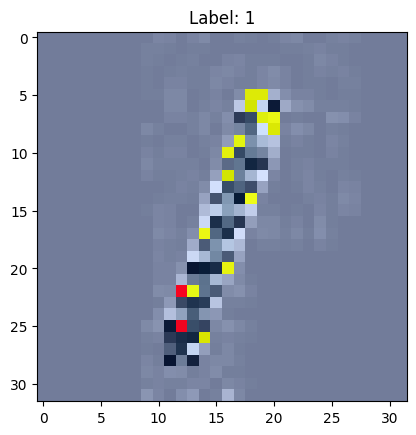

In [37]:
sample_indx = 42
show_image(sample_x_train[sample_indx], title=f"Label: {sample_y_train[sample_indx]}")

In [38]:
sample_intermediate_outputs_for_parameters = get_intermediate_outputs_for_parameters(
    model=MODEL,
    x=sample_x_train
)

sample_intermediate_outputs_for_layers = get_intermediate_outputs_for_layers(
    model=MODEL,
    x=sample_x_train
)

sample_weights, sample_grads = get_weights_and_grads_for_layers(
    model=MODEL,
    x=sample_x_train,
    y_true=sample_y_train,
    loss_fn=None
)

In [39]:
def plot_weight_and_spectrum(weights):
    """
    For each weight matrix in weights (dict: name -> tensor),
    this function plots:
      (1) Weight matrix as an image with its own colorbar
      (2) Singular value power spectrum
    """
    for name, w in weights.items():
        # Only process 2D weight matrices
        if w.ndim != 2:
            continue

        # Convert to numpy
        w_numpy = w.detach().cpu().numpy()  # torch_to_numpy replacement

        # Perform SVD
        U, S, Vt = np.linalg.svd(w_numpy, full_matrices=False)

        # Create subplot figure
        fig, ax = plt.subplots(1, 2, figsize=(30, 15))

        # Plot weight matrix
        im = ax[0].imshow(w_numpy, aspect='auto', cmap='plasma')
        ax[0].set_title(f"Weight Matrix\n{name}")
        ax[0].set_xlabel("Input Dimension")
        ax[0].set_ylabel("Output Dimension")

        # *** Add colorbar ***
        cbar = fig.colorbar(im, ax=ax[0])
        cbar.set_label("Weight Value", rotation=270, labelpad=15)

        # Plot singular values (power spectrum)
        ax[1].plot(S)
        ax[1].set_title(f"Singular Values (Power Spectrum)\n{name}")
        ax[1].set_xlabel("Index")
        ax[1].set_ylabel("Magnitude")

        plt.tight_layout()
        plt.show()


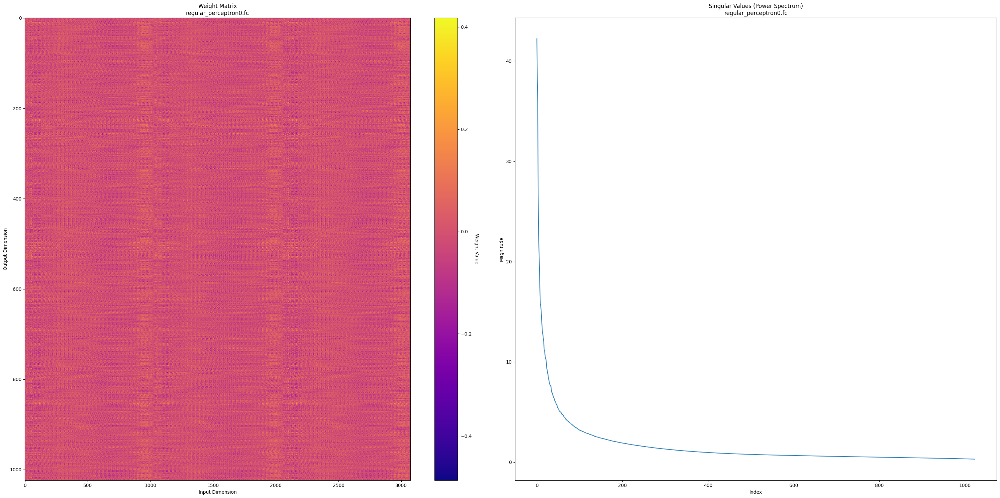

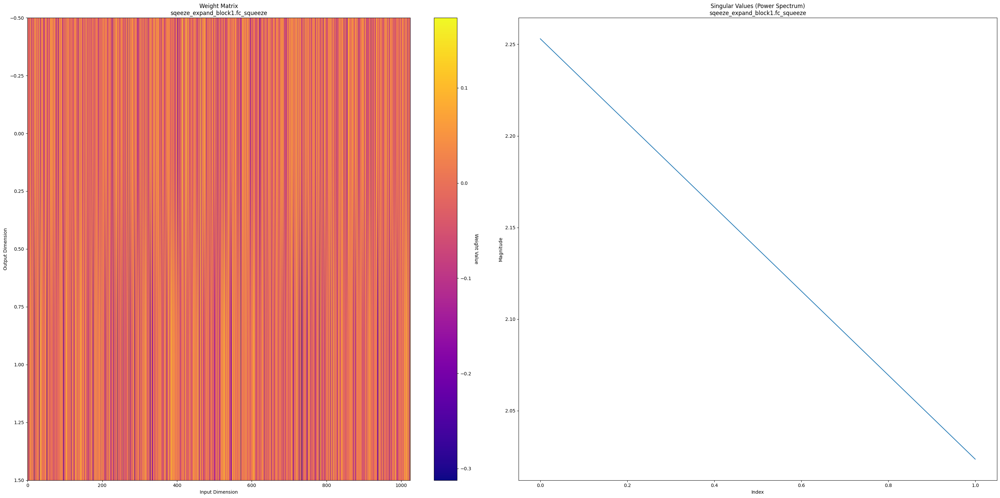

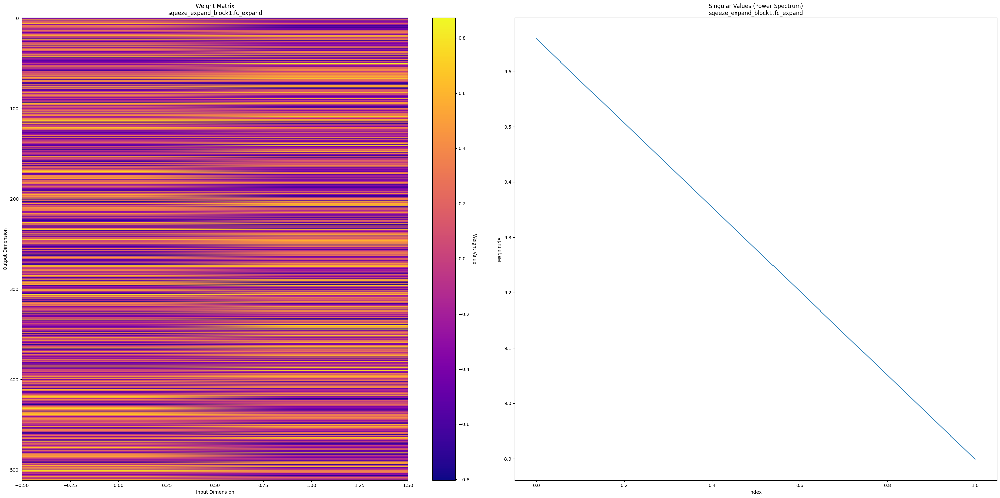

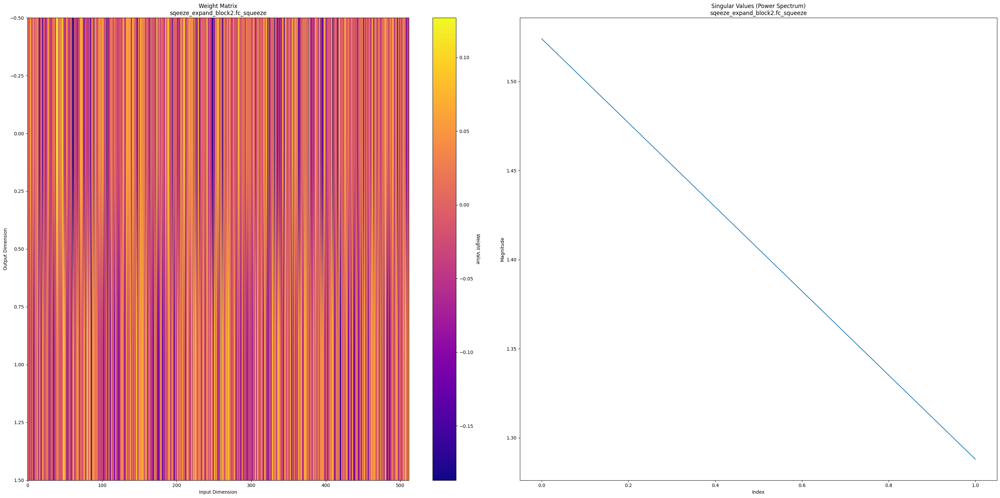

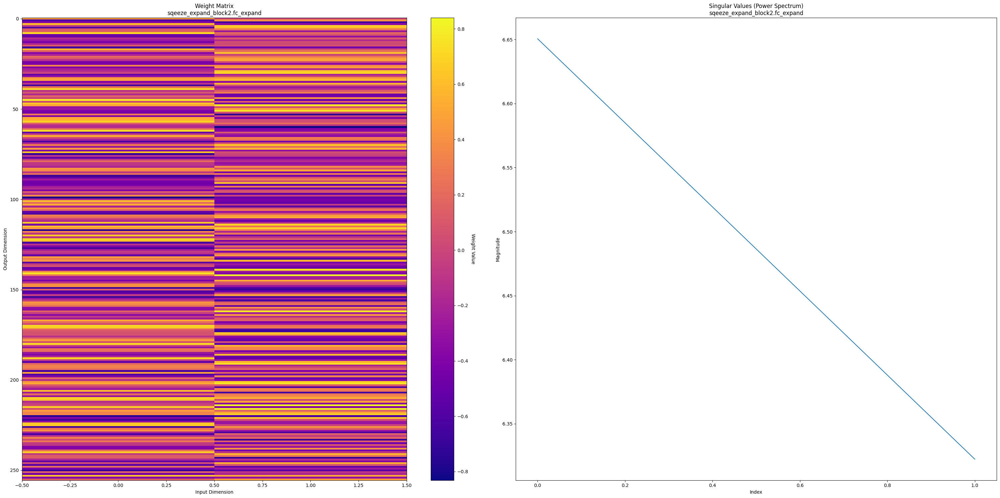

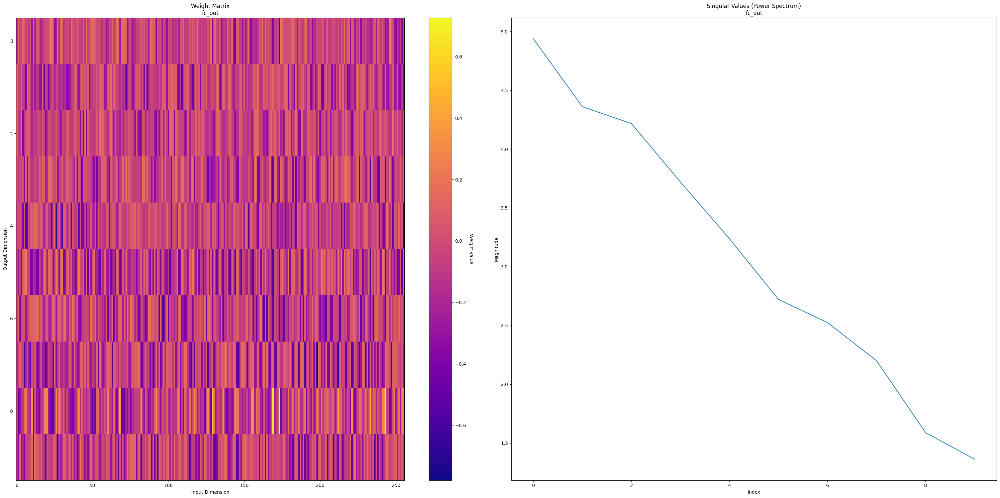

In [40]:
plot_weight_and_spectrum(sample_weights)

In [41]:
def plot_feature_and_spectrum(features):
    """
    For each feature matrix (dict: name -> tensor),
    this function plots:
      (1) feature matrix as an image
      (2) Singular value power spectrum
    """
    def activation(x, scale=False, temp=1.0):
      # """Sigmoid-like activation or scaled normalization."""
      # if scale:
      #     return (x - np.min(x)) / (np.max(x) - np.min(x))
      # return 1. / (1. + np.exp(-x / temp))
      return np.maximum(0, x)

    for name, a in features.items():
        # Only process 2D feature matrices
        if a.ndim != 2: # or 'weight' not in name:
            continue

        # Convert to numpy
        a_numpy = a.detach().cpu().numpy()  # torch_to_numpy replacement

        # Perform SVD
        U, S, Vt = np.linalg.svd(a_numpy, full_matrices=False)

        # Create subplot figure
        fig, ax = plt.subplots(1, 2, figsize=(30, 15))

        # Plot weight matrix
        im = ax[0].imshow(activation(a_numpy), aspect='auto', cmap='plasma')
        ax[0].set_title(f"ReLU Activated Feature Matrix\n{name}")
        ax[0].set_xlabel("Feature Index")
        ax[0].set_ylabel("Batch")
        # ax[0].axis('off')

        # *** Add colorbar ***
        cbar = fig.colorbar(im, ax=ax[0])
        cbar.set_label("Feature Value", rotation=270, labelpad=15)

        # Plot singular values (power spectrum)
        ax[1].plot(S)
        ax[1].set_title(f"Singular Values (Power Spectrum)\n{name}. Min = {np.min(S)}, Max = {np.max(S)}")
        ax[1].set_xlabel("Feature EV Index")
        ax[1].set_ylabel("Magnitude")

        plt.tight_layout()
        plt.show()

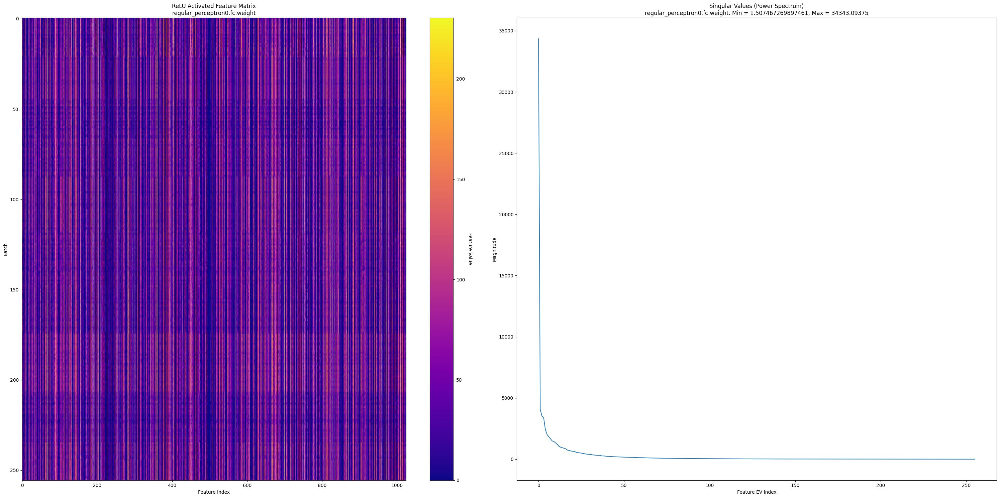

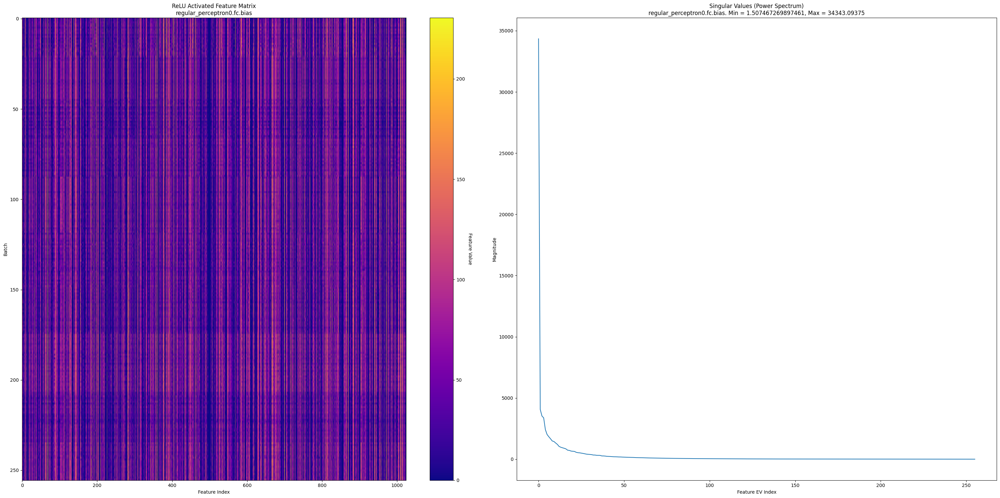

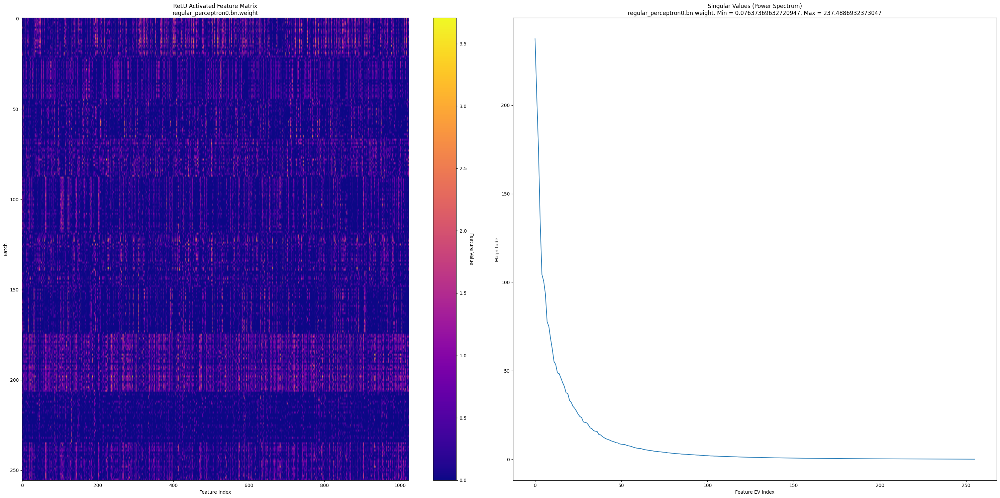

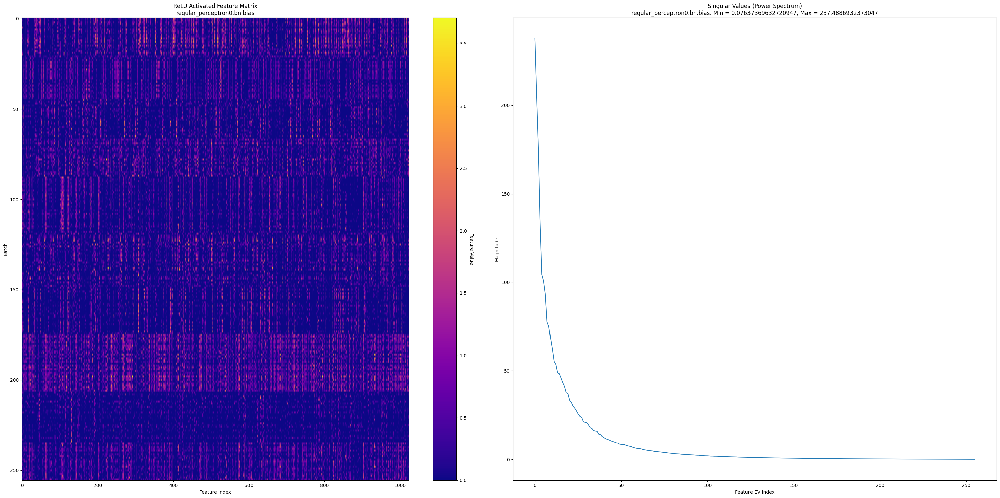

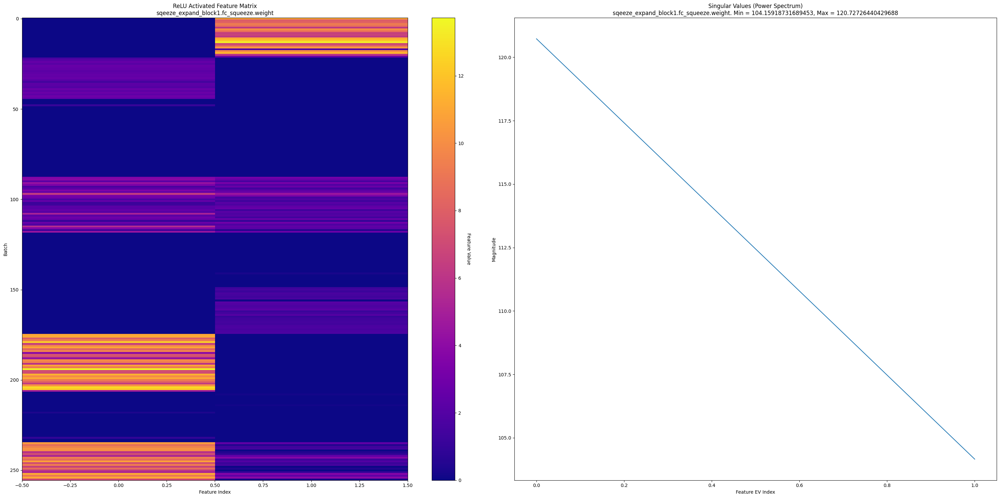

...

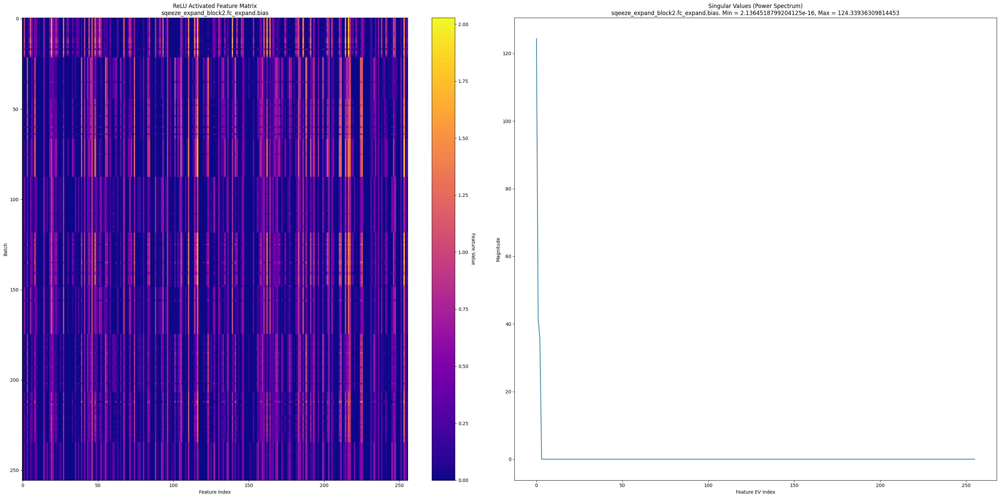

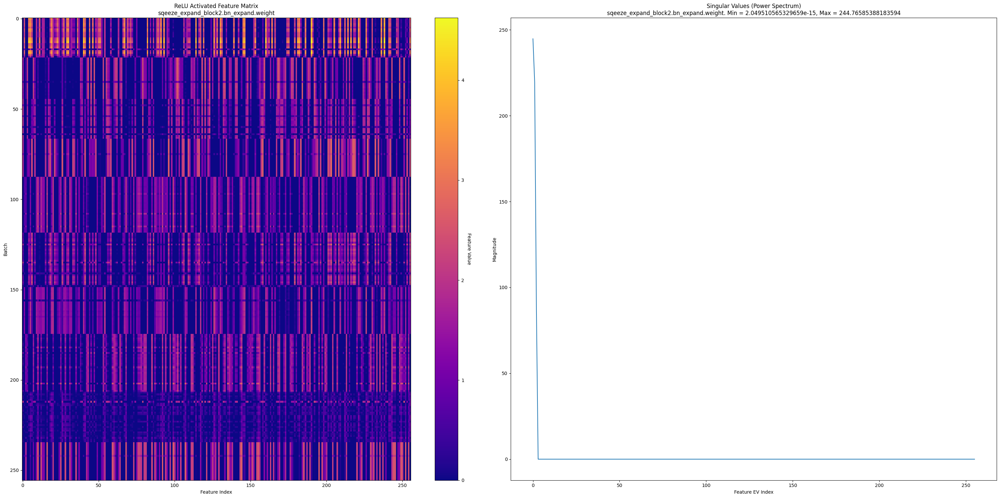

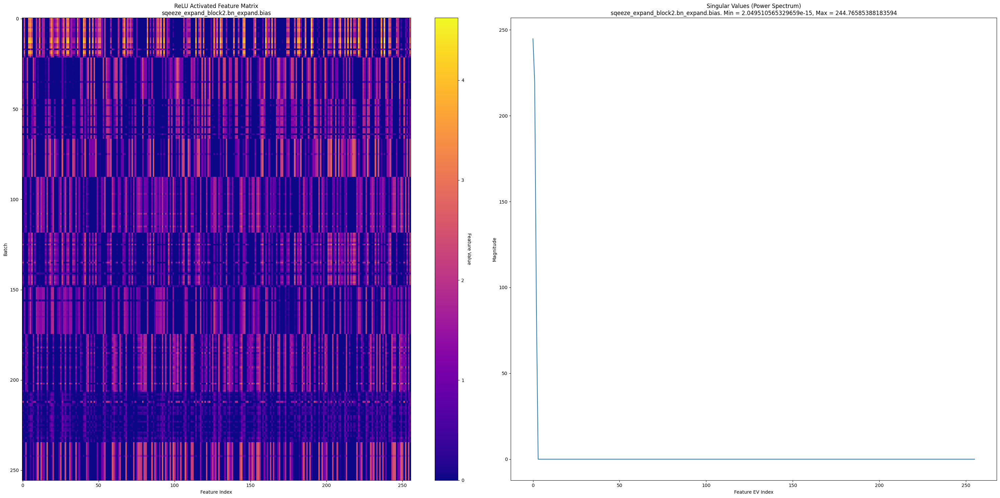

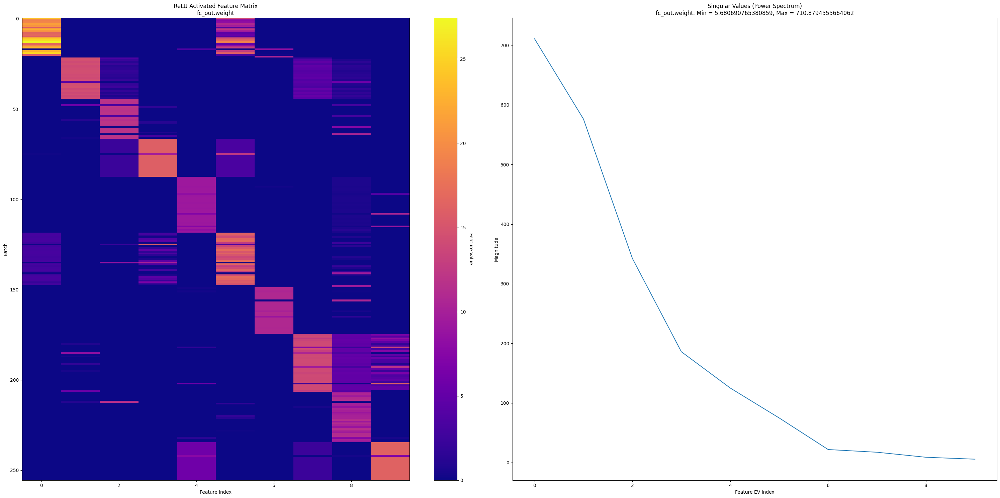

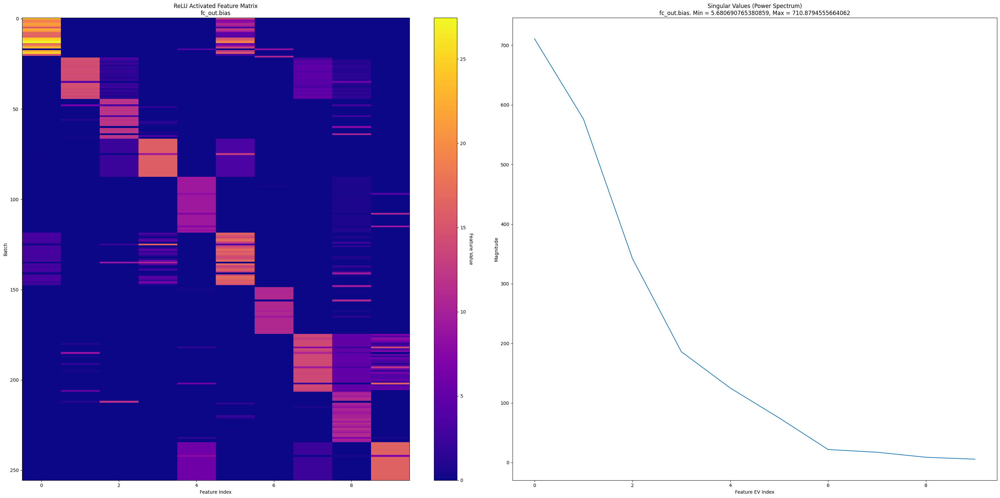

In [42]:
plot_feature_and_spectrum(sample_intermediate_outputs_for_parameters)

# pip install torchinfo torchview


In [43]:
!pip install torchinfo torchview
from torchinfo import summary
from torchview import draw_graph
from PIL import Image

In [44]:
summary(MODEL.to('cuda'), input_size=(1, 3, 32, 32))

Layer (type:depth-idx)                   Output Shape              Param #
CustomModel                              [1, 10]                   --
├─RegularPerceptron: 1-1                 [1, 1024]                 --
│    └─Linear: 2-1                       [1, 1024]                 3,146,752
│    └─BatchNorm1d: 2-2                  [1, 1024]                 2,048
├─SqueezeExpandBlock: 1-2                [1, 512]                  --
│    └─Linear: 2-3                       [1, 2]                    2,050
│    └─BatchNorm1d: 2-4                  [1, 2]                    4
│    └─Linear: 2-5                       [1, 512]                  1,536
│    └─BatchNorm1d: 2-6                  [1, 512]                  1,024
├─SqueezeExpandBlock: 1-3                [1, 256]                  --
│    └─Linear: 2-7                       [1, 2]                    1,026
│    └─BatchNorm1d: 2-8                  [1, 2]                    4
│    └─Linear: 2-9                       [1, 256]                

In [45]:
graph = draw_graph(
    MODEL.to('cpu'),
    input_data=sample_x_train.to('cpu'),
    expand_nested=True,      # shows SqueezeExpandBlock internals
    depth=4,                 # how many layers deep to display
)

graph.visual_graph.render("model_box_diagram", format="png")

'model_box_diagram.png'

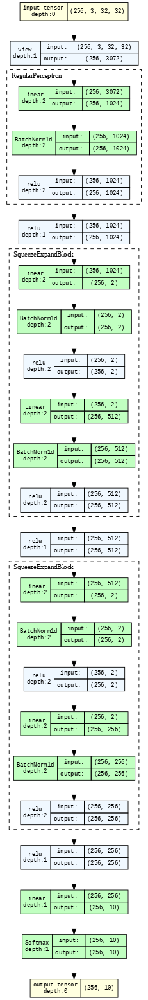

In [46]:
Image.open('model_box_diagram.png')